# Introduction à Qiskit

Qiskit est un cadre open-source pour travailler avec des ordinateurs quantiques. Il est entretenu et développé par IBM. Il fournit des outils pour créer, manipuler et simuler des circuits quantiques. Qiskit comprend également des bibliothèques pour différents algorithmes quantiques. Il dispose d'une communauté développée (disponible sur Slack) et d'une documentation détaillée ([documentation Qiskit](https://docs.quantum.ibm.com/)).


La base de Qiskit est le module Terra, qui fournit les outils essentiels pour construire et exécuter des circuits quantiques. En outre, Terra définit les interfaces pour l'expérience de l'utilisateur final et les couches d'optimisation, d'ordonnancement des impulsions et de communication avec le backend. Le tutoriel détaillé et plus complet se trouve [ici](https://docs.quantum.ibm.com/guides).

Le module Aer comprend différents émulateurs qui peuvent imiter l'ordinateur quantique en fonctionnement. Aer fournit un cadre d'émulation de haute performance pour les circuits quantiques en utilisant la pile logicielle Qiskit. Il contient des backends d'émulateur C++ optimisés pour l'exécution de circuits compilés en Terra.

Pour créer un circuit quantique, nous devons créer une instance de la classe <span style="background-color:lightgray">QuantumCircuit</span> et spécifier le nombre de qubits. 


## Installation

https://docs.quantum.ibm.com/guides/install-qiskit

%! pip install qiskit
%! pip install qiskit-ibm-runtime
%! pip install qiskit[visualization]

## Création des circuits quantiques

L'élément fondamental de l'informatique quantique est le circuit quantique. Il s'agit d'une séquence ordonnée de portes quantiques, de mesures et de réinitialisations, qui peut être conditionnée par un calcul classique en temps réel. Tout programme quantique peut être représenté par une séquence de circuits quantiques et de calculs classiques en temps réel.

Dans Qiskit, cet élément central est représenté par la classe <span style="background-color:lightgray">QuantumCircuit</span>.


In [9]:
from qiskit import QuantumCircuit

circuit = QuantumCircuit(4, 2) # Créer un objet QuantumCircuit de 4 qubits
circuit.draw() # Visualisez le circuit (il s'agit pour l'instant d'un circuit vide, mais on peut remarquer que la désignation des qubits commence à zéro).

q_0: 
     
q_1: 
     
q_2: 
     
q_3: 
     
c: 2/

Après avoir créé le circuit vide avec ses registres quantiques, nous pouvons ajouter les opérateurs (portes) quantiques pour développer et exécuter le circuit. Dans Qiskit, les opérateurs peuvent être ajoutés au circuit un par un. La liste complète des portes disponibles et de leur utilisation peut être trouvée dans la documentation de Qiskit.

Par exemple, voir : [circuits quantiques](https://docs.quantum.ibm.com/guides/construct-circuits).

Il est important de noter que les opérateurs (portes) sont ajoutées au circuit comme un appel de méthode sur le même objet circuit (QuantumCircuit).

In [10]:
circuit.h(2)     # Ajoute une porte de Hadamard H gate on le troixième qubit (qubit 3)
circuit.cx(2, 3) # Ajoute une CX (CNOT) porte sur le qubit de contrôle, qubit 3, et sur le qubit cible, qubit 4
circuit.x(0)     # Ajoute une porte X de Pauli sur le premier qubit
circuit.draw()   # Dessine le circuit

┌───┐     
q_0: ┤ X ├─────
     └───┘     
q_1: ──────────
     ┌───┐     
q_2: ┤ H ├──■──
     └───┘┌─┴─┐
q_3: ─────┤ X ├
          └───┘
c: 2/══════════

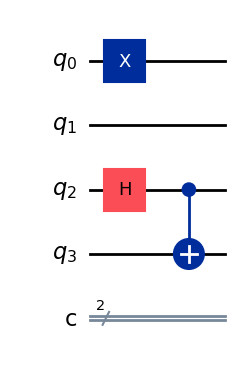

In [11]:
circuit.draw('mpl') # Dessiner un circuit en utilisant matplotlib pour avoir un dessin plus joli

En utilisant le module Aer de Qiskit, nous pouvons obtenir les résultats d'une simulation parfaite du circuit quantique souhaité. Cela signifie que nous obtiendrons des résultats sans bruit ni erreur, ce qui n'est pas valable pour un véritable ordinateur quantique à l'ère du NISQ.

Pour effectuer une simulation à l'aide de l'émulateur Aer, nous devons tout d'abord choisir le backend qui sera utilisé. Dans ce contexte, le backend représente la machine qui exécute notre circuit.

Dans cet exemple, le circuit quantique fonctionnera sur un émulateur de vecteurs d'état qui s'exécutera sur la machine locale. Après avoir choisi le backend, nous exécutons le circuit en appelant la méthode run(), qui renvoie un objet job qui encapsule toutes les informations nécessaires sur le circuit soumis à l'exécution.

In [17]:
from qiskit_aer import Aer

backend = Aer.get_backend("statevector_simulator")
job = backend.run(circuit)

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.


L'objet job créé après l'exécution du circuit sur un backend possède deux méthodes essentielles. L'une est status(), qui renvoie l'état de la tâche, et l'autre est result(), qui renvoie le résultat de la tâche. Il est essentiel de savoir que le travail s'exécute de manière asynchrone, de sorte que nous n'obtenons pas les résultats automatiquement, mais que nous devons les attendre.

Il existe deux approches possibles pour obtenir le résultat d'un travail :

Appeler la méthode status() pour vérifier l'état actuel d'un travail. Si l'état d'un travail est terminé, nous pouvons obtenir ses résultats ; sinon, nous pouvons attendre un certain temps et revérifier l'état jusqu'à ce que le travail soit terminé. Enfin, nous pouvons obtenir les résultats du travail.
Appelez la fonction result(), qui se bloque pendant qu'elle attend la fin d'un travail. Elle reviendra lorsque l'exécution du travail sera terminée.

In [18]:
from qiskit.providers import JobStatus
import time

# First approach
job_final_states = [JobStatus.DONE, JobStatus.ERROR, JobStatus.CANCELLED]
def get_job_result(job_obj):
    status = job_obj.status()
    if status in job_final_states:
        return job_obj.result()
    time.sleep(1)

result = get_job_result(job)
print(f"Counts: {result.get_counts()}")

# Second approach
result = job.result()
print(f"Statevector: {result.get_statevector().data}")

Counts: {'00': 1}
Statevector: [0.        +0.j 0.70710678+0.j 0.        +0.j 0.        +0.j
 0.        +0.j 0.        +0.j 0.        +0.j 0.        +0.j
 0.        +0.j 0.        +0.j 0.        +0.j 0.        +0.j
 0.        +0.j 0.70710678+0.j 0.        +0.j 0.        +0.j]


## OpenQASM

Nous pouvons obtenir le format OpenQASM du circuit quantique à l'aide de la bibliothèque Qiskit.

OpenQASM est l'acronyme de Open Quantum Assembly Language (langage d'assemblage quantique ouvert) développé par IBM. Il s'agit d'un langage textuel qui décrit les circuits quantiques mis en œuvre sur un ordinateur quantique ou simulés sur un ordinateur classique. Il s'agit d'un langage de bas niveau qui permet d'exprimer des algorithmes quantiques d'une manière indépendante du matériel spécifique utilisé.

qasm() dans Qiskit devrait convertir notre circuit quantique au format QASM, mais sa fonctionnalité présente des problèmes connus. Par exemple, il est possible que la chaîne QASM obtenue soit erronée, en particulier pour les circuits de grande taille, c'est pourquoi nous devons faire attention lorsque nous utilisons cette méthode et vérifier ses résultats.

In [20]:
qasm_str = circuit.qasm2()
print(qasm_str)

AttributeError: 'QuantumCircuit' object has no attribute 'qasm2'

In [15]:
circuit2 = QuantumCircuit.from_qasm_str(qasm_str)
circuit2.draw('mpl')

NameError: name 'qasm_str' is not defined

## Visualisation

In [21]:
from qiskit.visualization import plot_bloch_vector, plot_bloch_multivector
from qiskit.visualization import visualize_transition
import qiskit.quantum_info as qi

circuit = QuantumCircuit(1)
circuit.h(0)
circuit.z(0)

circuit.draw('mpl')

visualize_transition(circuit)

/var/folders/l9/j_8nkb010vb456g_n0s05ydw0000gn/T/ipykernel_82765/1349665956.py:11: DeprecationWarning: The function ``qiskit.visualization.transition_visualization.visualize_transition()`` is deprecated as of qiskit 1.2.0. It will be removed in the 2.0 release.
  visualize_transition(circuit)


Statevector([ 0.70710678+0.j, -0.70710678+0.j],
            dims=(2,))


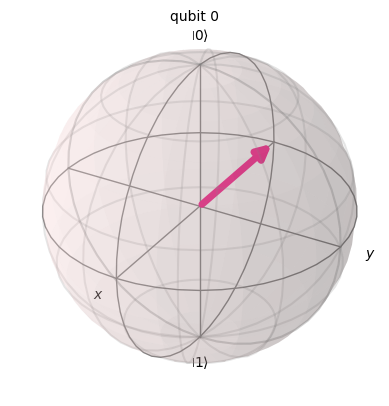

In [22]:
print(qi.Statevector.from_instruction(circuit))
plot_bloch_multivector(qi.Statevector.from_instruction(circuit).data)

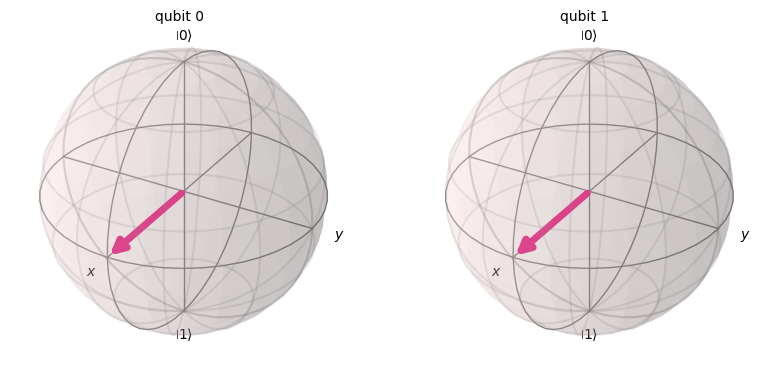

In [23]:
circuit = QuantumCircuit(2)
circuit.h(0)
circuit.h(1)
circuit.x(0)
circuit.cx(0, 1)

state_vector = qi.Statevector.from_instruction(circuit)
plot_bloch_multivector(state_vector.data)